
# Preprocessing - SCT & Scran Normalization
Michael Sterr

2021-09-25 19:42:53      


# Setup

Run following scripts before:
 * 4-X_scMultiome_FVF-Gut_Preprocessing_Doublet-Detection_XXX-XXX_v1

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_92384/495279268.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [3]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
from itertools import chain

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
from matplotlib import cm
import seaborn as sb

# Analysis
import scanpy as sc
import scvelo as scv

In [6]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_versions()

## ScVelo settings
scv.settings.verbosity = 3
scv.logging.print_versions()

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
#pandas2ri.activate()
#anndata2ri.activate()
#%load_ext rpy2.ipython

-----
anndata     0.8.0
scanpy      1.9.1
-----
PIL                 9.2.0
appnope             0.1.3
asttokens           NA
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
cffi                1.15.1
colorama            0.4.5
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.0
decorator           5.1.1
defusedxml          0.7.1
entrypoints         0.4
executing           0.8.3
h5py                3.7.0
hypergeom_ufunc     NA
igraph              0.9.11
ipykernel           6.9.1
ipython_genutils    0.2.0
jedi                0.18.1
joblib              1.1.0
jupyter_server      1.18.1
kiwisolver          1.4.4
leidenalg           0.8.10
llvmlite            0.38.1
loompy              3.0.7
matplotlib          3.5.2
mpl_toolkits        NA
natsort             8.1.0
nbinom_ufunc        NA
numba               0.55.2
numpy               1.22.4
numpy_groupies      0.9.17
packaging           21.3
pandas              1.4.3
pars

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI's XMLRPC API is currently disabled due to unmanageable load and will be deprecated in the near future. See https://status.python.org/ for more information.


# Load Data

In [6]:
adata=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets.h5ad')
adata_wsnn=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized.h5ad')


In [7]:
adata_wknn=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_wknn.h5ad')

In [ ]:
#Normalize adata 
adata.X /= adata.obs['size_factors'].values[:,None]
sc.pp.log1p(adata)

#Keep the normalized count data in a counts layer
adata.layers['scran_counts'] = adata.X.copy()

In [7]:
%%R -o adata_sct

adata_sct <- readRDS('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_rmDoublets_sctNormalized_sce.rds')

UsageError: Cell magic `%%R` not found.


# Add Normalization from Seurat SCT 

Loading SCT normalized date without doublets.

Run following scripts before:
 * 7_scMultiome_FVF-Gut_Preprocessing_SCT-WNN.rmd

In [14]:
%%R -o adata_sct

adata_sct <- readRDS('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_rmDoublets_sctNormalized_sce.rds')

In [15]:
adata_sct.layers['sct_counts'] = adata_sct.X.copy()

In [16]:
# Harmonize features
adata = adata[:,adata_sct.var_names].copy()

In [17]:
# Add SCT data
adata.layers['sct_counts'] = adata_sct.layers['sct_counts']
adata.layers['sct_logcounts'] = adata_sct.layers['sct_logcounts']
adata.layers['sct_scale_data'] = adata_sct.layers['sct_scale_data']
adata.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']] = adata_sct.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']]

In [18]:
# Put X in a layer to keep it after merging
adata_sct.layers['sct_counts'] = adata_sct.X.copy()

# Keep raw QC metrics & counts
adata.obs['mt_frac_raw'] = adata.obs['mt_frac']
adata.obs['rp_frac_raw'] = adata.obs['rp_frac']
adata.obs['n_genes_raw'] = adata.obs['n_genes']
adata.obs['log_genes_raw'] = adata.obs['log_genes']
adata.obs['n_counts_raw'] = adata.obs['n_counts']
adata.obs['log_counts_raw'] = adata.obs['log_counts']
#adata.layers['raw_counts'] = adata.X

# Add SCT data
adata.layers['sct_counts'] = adata_sct.layers['sct_counts']
adata.layers['sct_logcounts'] = adata_sct.layers['sct_logcounts']
adata.layers['sct_scale_data'] = adata_sct.layers['sct_scale_data']
adata.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']] = adata_sct.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']]

# Set normalized counts as X for QC metrics
adata.X = adata.layers['sct_counts']
adata.X=adata.X.toarray()

# Filter genes: Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

filtered out 4086 genes that are detected in less than 20 cells
Number of genes after cell filter: 14663


In [19]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)
adata.obs['log_genes'] = np.log(adata.obs['n_genes'])

mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

rp_gene_mask = [gene.startswith(('Rps','Rpl')) for gene in adata.var_names]
adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

In [20]:
# Set log-normalized counts as X
adata.X = adata.layers['sct_logcounts']
adata.X=adata.X.toarray()

# Store the full data set in 'raw' as log-normalized data for statistical testing
adata.raw = adata

In [21]:
# Calc umap & trimap
hvgs = pd.Series(adata.var['sct.variable'][adata.var['sct.variable'] > 0].index) # use HVGs from sct
adata.var['highly_variable']= False
adata.var['highly_variable'][hvgs] = True

sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(adata, metric='correlation', n_neighbors=20, n_pcs=30)
sc.tl.leiden(adata, resolution=0.5)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [22]:

print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

#sc.pl.highly_variable_genes(adata)


 Number of highly variable genes: 1984


# Add WNN Graph

In [23]:
# Harmonize vars
adata_wsnn = adata_wsnn[:,adata_wsnn.var_names.isin(adata.var_names)].copy()

In [24]:
adata.uns['neighbors_wnn'] = adata_wsnn.uns['neighbors'].copy()

In [ ]:
#TODO: Get the connectivities of the WNN neighbor graph

In [25]:
adata.uns['neighbors_wnn']['connectivities'] = adata_wknn.uns['neighbors']['distances'].copy()

In [26]:
adata.uns['neighbors_wnn']['connectivities_key'] = 'connectivities'
adata.uns['neighbors_wnn']['distances_key'] = 'distances'
adata.uns['neighbors_wnn']['params'] = {'method': 'wsnn', 'metric': 'correlation', 'n_neighbors': 20}

In [27]:
adata.obsm['X_umap_wsnn'] = adata_wsnn.obsm['X_umap'].copy()
adata.obsm['X_pca_wsnn'] = adata_wsnn.obsm['X_pca'].copy()
adata.obsm['X_spca_wsnn'] = adata_wsnn.obsm['X_spca'].copy()

In [28]:
adata.varm['PCs_wsnn'] = adata_wsnn.varm['PCs'].copy()
adata.varm['SPCA_wsnn'] = adata_wsnn.varm['SPCA'].copy()

# Save

In [29]:
# Save
sc.write('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN', adata)

# Compare Results

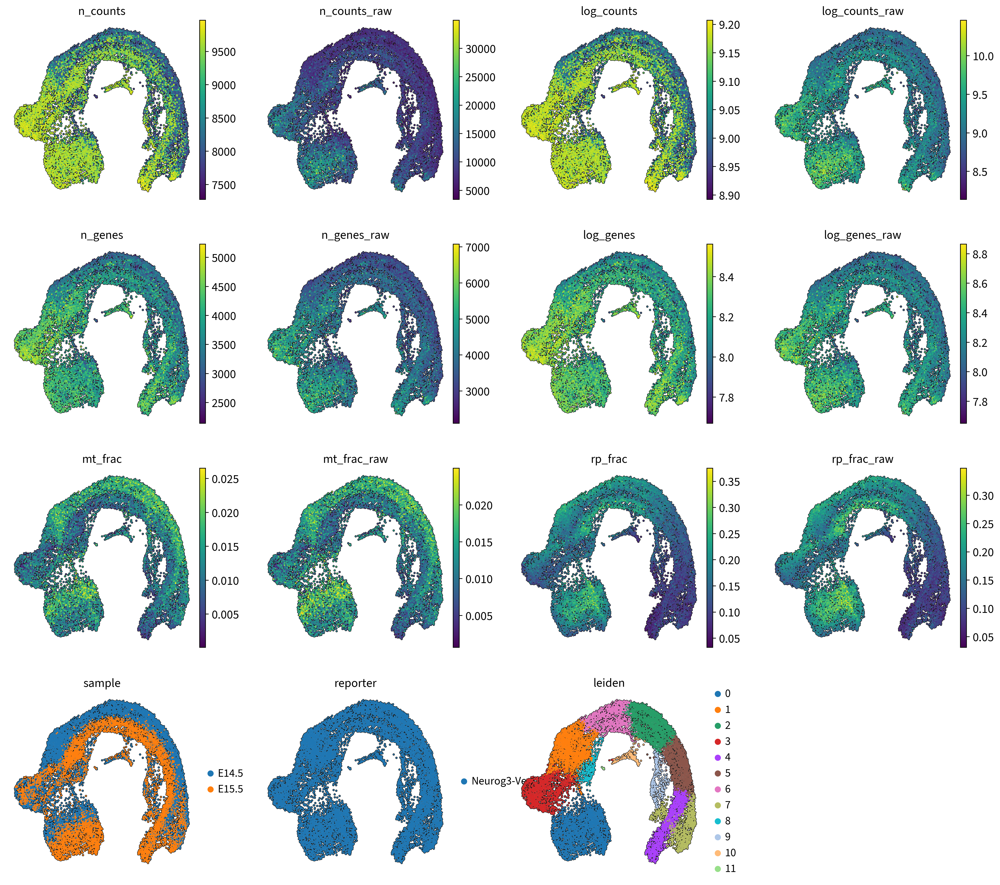

In [30]:
sc.pl.umap(adata, color=['n_counts', 'n_counts_raw', 'log_counts', 'log_counts_raw','n_genes','n_genes_raw','log_genes','log_genes_raw','mt_frac','mt_frac_raw','rp_frac','rp_frac_raw','sample','reporter','leiden'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

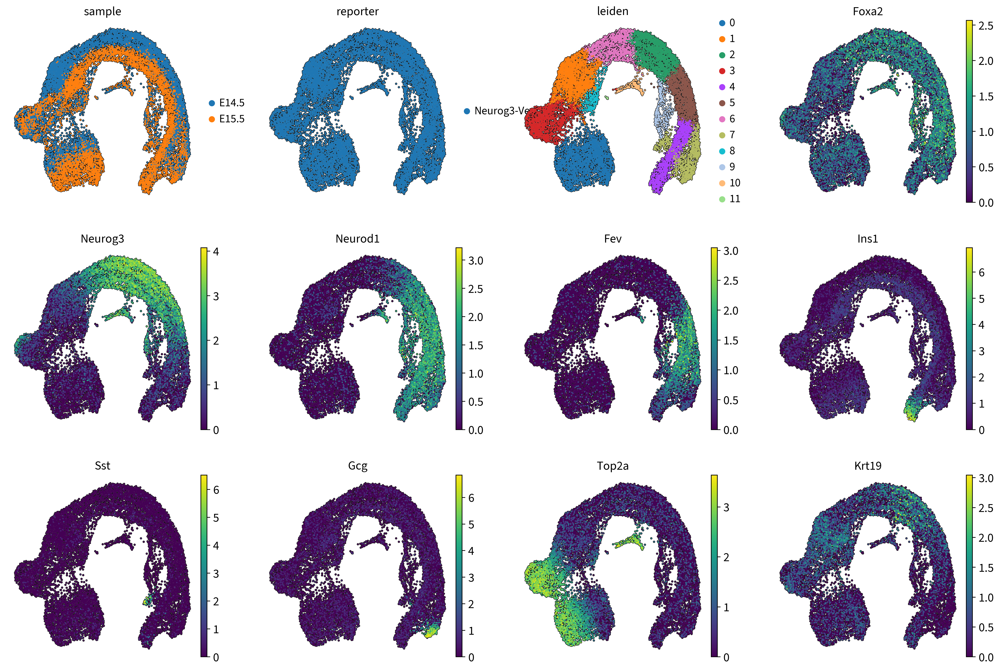

In [31]:
sc.pl.umap(adata, color=['sample','reporter','leiden','Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

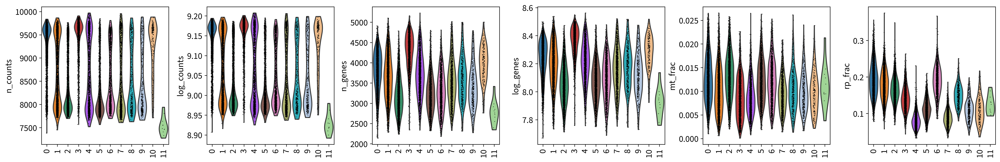

In [32]:
sc.pl.violin(adata, use_raw=False, keys=['n_counts', 'log_counts','n_genes','log_genes','mt_frac','rp_frac'], groupby='leiden', rotation=90)

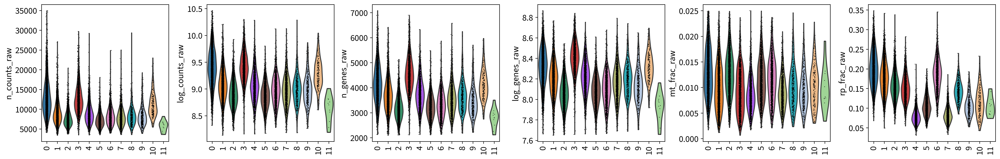

In [33]:
sc.pl.violin(adata, use_raw=False, keys=['n_counts_raw', 'log_counts_raw','n_genes_raw','log_genes_raw','mt_frac_raw','rp_frac_raw'], groupby='leiden', rotation=90)

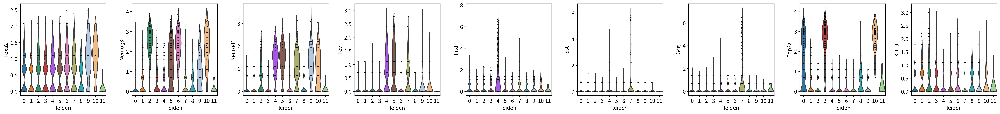

In [34]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='raw_counts')

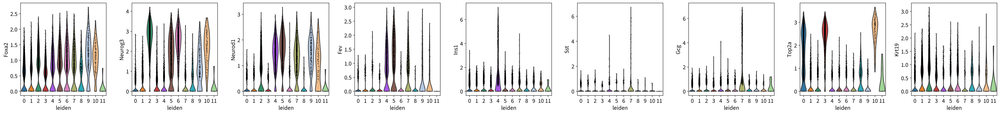

In [35]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='scran_counts')

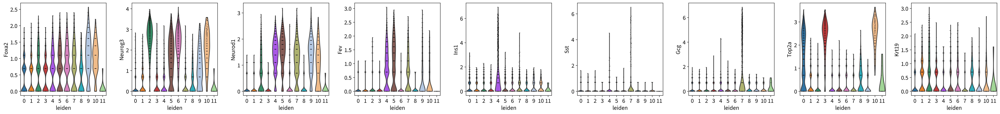

In [36]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden')

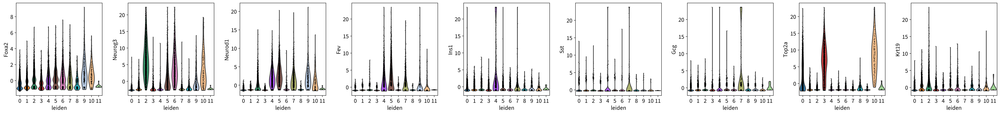

In [37]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='sct_scale_data')

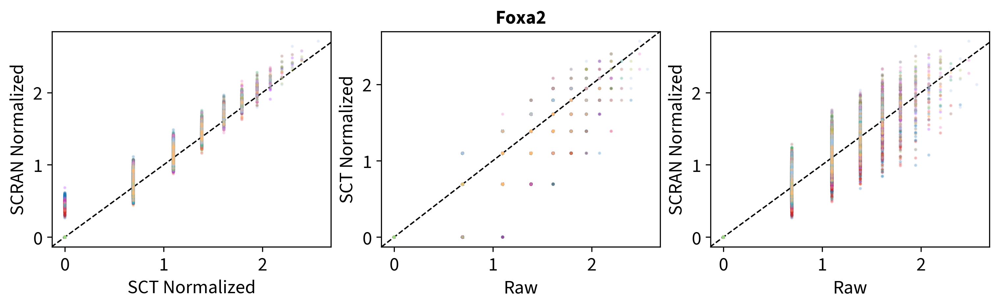

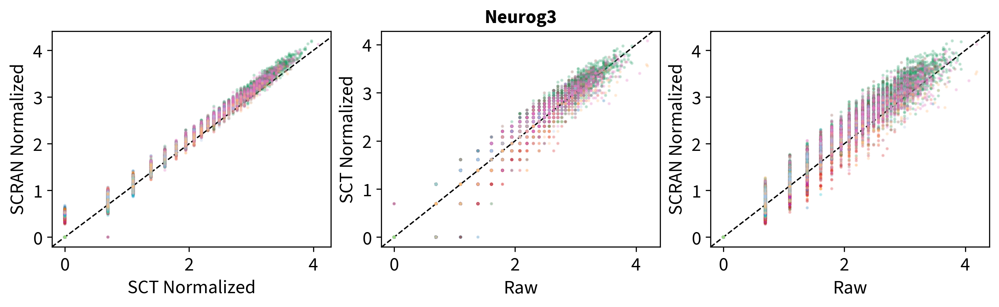

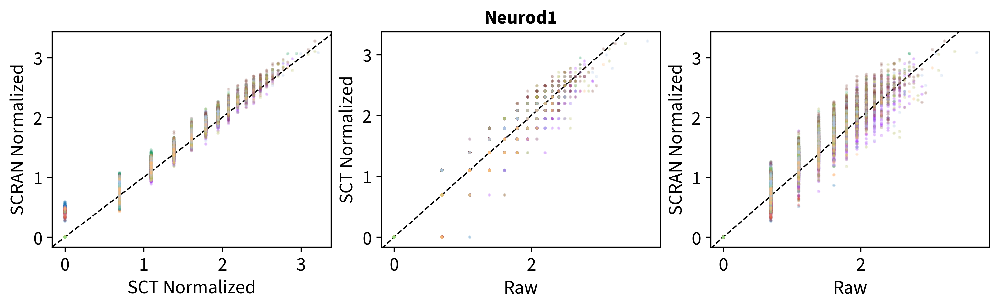

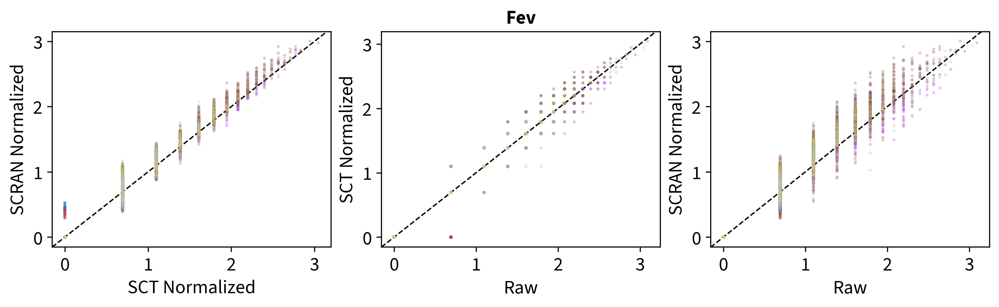

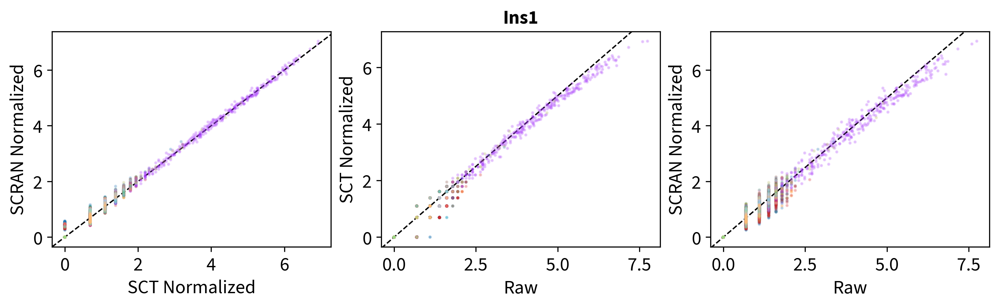

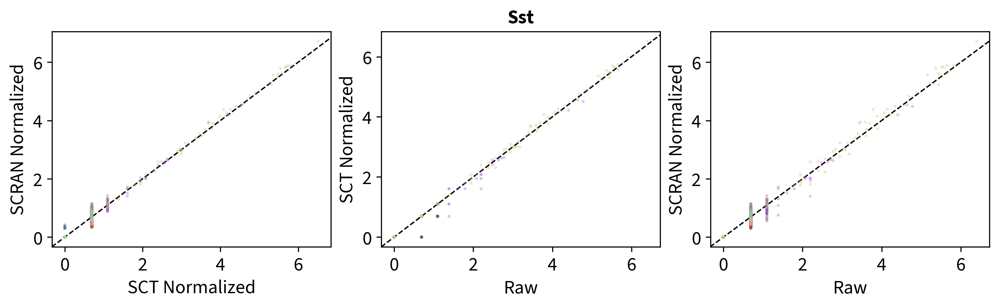

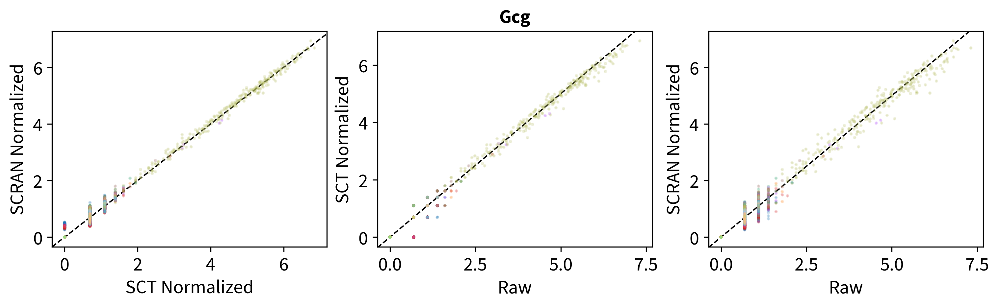

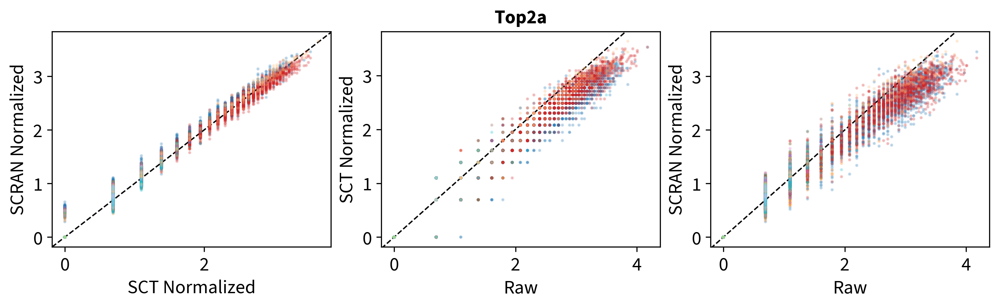

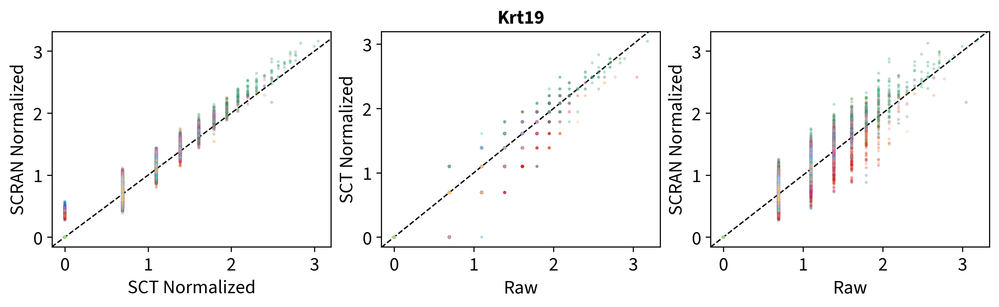

In [38]:
genes = ['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19']
for gene in genes:
    df = pd.DataFrame({'sct':list(chain.from_iterable(adata[:,gene].layers['sct_logcounts'].toarray())), 'scran':list(chain.from_iterable(adata[:,gene].layers['scran_counts'].toarray())), 'raw':list(chain.from_iterable(adata[:,gene].layers['log_raw_counts'].toarray())), 'leiden':list(adata.obs['leiden'].astype(int))})
    df = df.sort_values(by=['leiden'])
    df.loc[:,'leiden'] = df.loc[:,'leiden'].astype('category')
    lims_x = []
    lims_y = []
    lims_line = []

    fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(10, 3))
    # Plots
    axs[0].scatter(df.loc[:,'sct'], y=df.loc[:,'scran'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))
    axs[1].scatter(df.loc[:,'raw'], y=df.loc[:,'sct'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))
    axs[2].scatter(df.loc[:,'raw'], y=df.loc[:,'scran'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))

    # Aesthetics
    for i,ax in enumerate(axs):
        lims_x.append(ax.get_xlim())
        lims_y.append(ax.get_ylim())
        lims_line.append([np.min([ax.get_xlim(), ax.get_ylim()]), np.max([ax.get_xlim(), ax.get_ylim()])])

    axs[0].set_xlabel('SCT Normalized')
    axs[0].set_ylabel('SCRAN Normalized')
    #axs[0].set_aspect('equal')
    axs[0].plot(lims_line[0], lims_line[0], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[0].set_xlim(lims_x[0])
    axs[0].set_ylim(lims_y[0])

    axs[1].set_xlabel('Raw')
    axs[1].set_ylabel('SCT Normalized')
    axs[1].set_title(gene, fontweight='bold')
    #axs[1].set_aspect('equal')
    axs[1].plot(lims_line[1], lims_line[1], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[1].set_xlim(lims_x[1])
    axs[1].set_ylim(lims_y[1])

    axs[2].set_xlabel('Raw')
    axs[2].set_ylabel('SCRAN Normalized')
    #axs[2].set_aspect('equal')
    axs[2].plot(lims_line[2], lims_line[2], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[2].set_xlim(lims_x[2])
    axs[2].set_ylim(lims_y[2])

    plt.show()

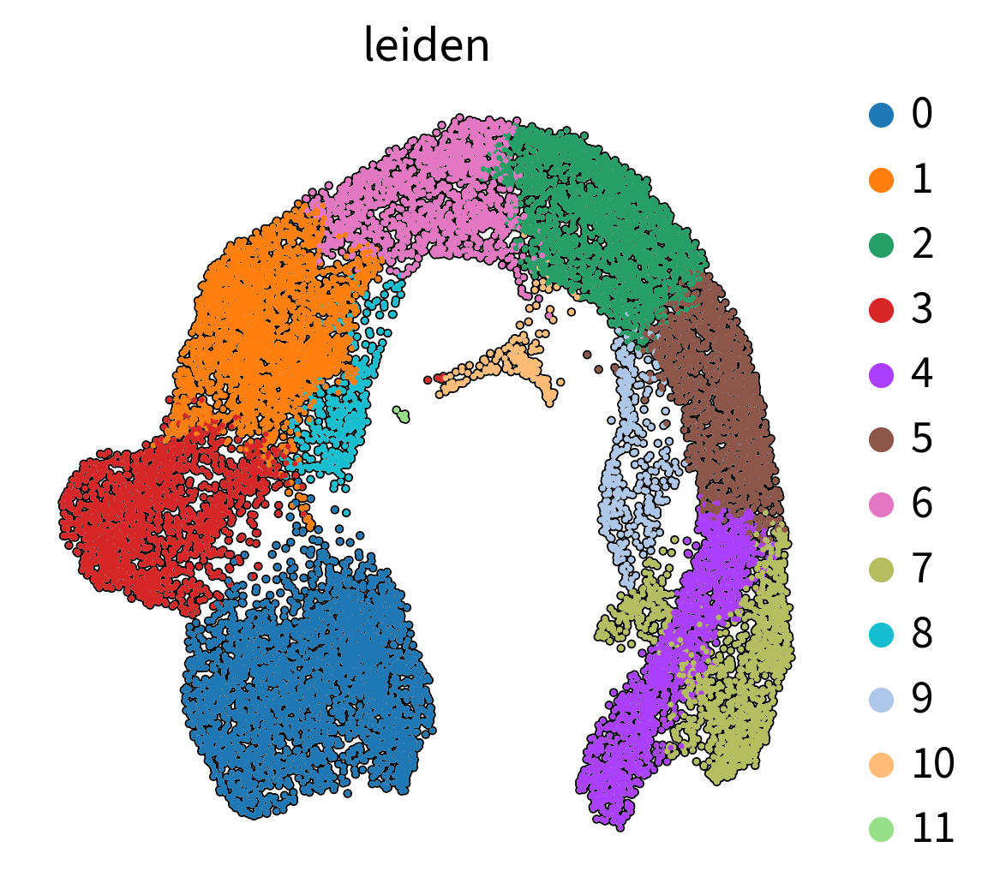

In [39]:
sc.pl.umap(adata, color=['leiden'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

In [40]:
%%R

sessionInfo()

R version 4.1.1 (2021-08-10)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/openblas-pthread/libblas.so.3
LAPACK: /usr/lib/x86_64-linux-gnu/openblas-pthread/liblapack.so.3

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
 [1] parallel  stats4    tools     stats     graphics  grDevices utils    
 [8] datasets  methods   base     

other attached packages:
 [1] scran_1.20.1                scuttle_1.2.0              
 [3] SingleCellExperiment_1.14.1 SummarizedExperiment_1.22.0
 [5] Biobase_2.52.0              GenomicRanges_1.44.0       
 [7] GenomeInfoDb_1.28.4         IR